## The Joint Chiropractic Analysis - PArt 1
#### By: Chris K. Green, Ph.D.

#### In this Notebook, the Joint Chiropractic location information will be scraped from its website. The associated data will then be fed to ArcGIS to determine the geo information. Foursquare can then be used to determine the nerby venues for each clinic and perform a K-mean analysis to classify the respective clinics.

In [1]:
import numpy as np # library to handle data in a vectorized manner

import pandas as pd # library for data analsysis
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

import json # library to handle JSON files

#!conda install -c conda-forge geopy --yes # uncomment this line if you haven't completed the Foursquare API lab
from geopy.geocoders import Nominatim # convert an address into latitude and longitude values

import requests # library to handle requests
from pandas.io.json import json_normalize # tranform JSON file into a pandas dataframe

# Matplotlib and associated plotting modules
import matplotlib.cm as cm
import matplotlib.colors as colors

# import k-means from clustering stage
from sklearn.cluster import KMeans

#!conda install -c conda-forge folium=0.5.0 --yes
import folium # map rendering library

print('Libraries imported.')

Libraries imported.


Determine the geographical coordinates near Atlanta,GA

In [2]:
address = 'United States'

geolocator = Nominatim(user_agent="to_explorer")
location = geolocator.geocode(address)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinates of Atlanta, GA  are {}, {}.'.format(latitude, longitude))

The geograpical coordinates of Atlanta, GA  are 39.7837304, -100.4458825.


#### Now, let's use foursquare to find all the Joint Chiropractics in the Atlanta area

In [3]:
CLIENT_ID = 'SJDL5MPZ5XJPAYO0ZWJGU2IWTJXTG21V0Z40UVRVICX31I1K' # your Foursquare ID
CLIENT_SECRET = 'EOIXHXP3ZN12RP3DE3JBVZCNW30ZJ4GOZGIN2TAOMRWUBZ5S' # your Foursquare Secret
VERSION = '20180605' # Foursquare API version

print('Your credentails:')
print('CLIENT_ID: ' + CLIENT_ID)
print('CLIENT_SECRET:' + CLIENT_SECRET)



Your credentails:
CLIENT_ID: SJDL5MPZ5XJPAYO0ZWJGU2IWTJXTG21V0Z40UVRVICX31I1K
CLIENT_SECRET:EOIXHXP3ZN12RP3DE3JBVZCNW30ZJ4GOZGIN2TAOMRWUBZ5S


#### Let's scrape the existing National locations from the Joint's website:

In [4]:
import bs4 as bs
import urllib.request

sauce = urllib.request.urlopen('https://www.thejoint.com/locations').read()
soup = bs.BeautifulSoup(sauce,'lxml')

#### This code creates list with each Chiropractor location's address

In [5]:
locations= []
street = []
zipcode = []

# Extracts the Location 
for div in soup.find_all('div', class_='clinic-name'):
    name = div.text.strip()
    locations.append(name)

# Extracts the Address, City and Zip Code
for address in soup.find_all('div', class_='clinic-address'): 
    if len(address)==3:
        joint_street = address.contents[0].strip()
        joint_zip = address.contents[2].strip()
        street.append(joint_street)
        zipcode.append(joint_zip)
    
    if len(address)==5:
        joint_street = address.contents[0].strip()+ ' '+address.contents[2].strip()
        joint_zip = address.contents[4].strip()
        street.append(joint_street)
        zipcode.append(joint_zip)



In [6]:
import pandas as pd # library for data analysis
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

column_names = ['Location', 'Street Address', 'Zip Code']
#column_names = ['Location', 'Address']
joint_df = []
joint_df = pd.DataFrame(columns=column_names)

joint_df.iloc[:,0] = locations
joint_df.iloc[:,1] = street
joint_df.iloc[:,2] = zipcode




#### Now, let's convert the extracted info into a Dataframe

In [7]:
joint_df

,Location,Street Address,Zip Code
0,The Joint Chiropractic - Gateway Crossing,"9925 West McDowell Road, Suite #102","Avondale, AZ 85392"
1,The Joint Chiropractic - Casa Grande,"1609 E. Florence Blvd., Suite 3","Casa Grande, AZ 85122"
2,The Joint Chiropractic - Ocotillo,"2895 S. Alma School Road, Suite #6","Chandler, AZ 85286"
3,The Joint Chiropractic - Chandler - Ahwatukee,"7131 W. Ray Rd., Suite 39","Chandler, AZ 85226"
4,The Joint Chiropractic - Flagstaff,"2700 S Woodlands Village Blvd, Ste. 440","Flagstaff, AZ 86001"
5,The Joint Chiropractic - San Tan Village,"2765 S. Market St., Ste 105","Gilbert, AZ 85295"
6,The Joint Chiropractic - Gilbert Town Square,1084 S. Gilbert Road #103,"Gilbert, AZ 85296"
7,The Joint Chiropractic - Arrowhead Ranch,"20280 N. 59th Avenue, Suite #107","Glendale, AZ 85308"
8,The Joint Chiropractic - Goodyear,"1468 N Litchfield Road, Suite M-6","Goodyear, AZ 85395"
9,The Joint Chiropractic - Dana Park,"3426 E. Baseline Road, Suite #116","Mesa, AZ 85204"


#### Before we can conduct a K-means analysis, we will need to obtain geographic Coordinates. ArcGis is used to grab the geo data.

In [8]:
# Imports appropriate modules for geocoding

from arcgis.gis import GIS
from arcgis.geocoding import geocode
from arcgis.geometry import Point
lat_lng_coords = None

gis = GIS("https://www.arcgis.com", "Capearcgis", "a7UJmLTR")

#### Obtain Geo Goordinates for all the Joint Stores nation wide

In [9]:
# Use This Loop to obtain coordinates info
coord_results = []

for coord in range(0,len(joint_df["Zip Code"])):
    check_address = joint_df["Street Address"][coord]
    check_city = joint_df["Zip Code"][coord]
    query_string=check_address+ ' ' +check_city # Need to include entire address query string
    geocode_result = geocode(address=query_string, as_featureset = False)[0]
    x_y_coord= geocode_result['location']
    coord_results.append(x_y_coord)


#### Now, create a new DF to store the Latitude and Longitude coordinates

In [10]:
df_coords=[]
df_coords=pd.DataFrame(coord_results)
df_coords.rename(columns={'x':'Longitude','y':'Latitude'}, inplace= True)

#### Combine the two dataframes into a new single df

In [11]:
df_chiro=pd.concat([joint_df, df_coords], axis=1) # Combines two df to make new one
df_chiro
df_save=pd.concat([joint_df, df_coords], axis=1) # Combines two df to make new one


In [12]:
df_save.to_csv(r"C:\Users\chris\Dropbox\Coursera\Joint_Locations_National.csv", sep =',', header = True)

#### Let's Visualize the Joint Chiropractic Franchises in the United States currently:

In [13]:
# create map of Joint Chiropractic locations in Atlant area using latitude and longitude values
map_atlanta = folium.Map(location=[latitude, longitude], zoom_start=4)

# add markers to map
for lat, lng, label in zip(df_chiro['Latitude'], df_chiro['Longitude'], df_chiro['Location']):
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color='blue',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(map_atlanta)  
    
map_atlanta

#### Allows above map to be exported as an hmtl file for later use

In [37]:
map_atlanta.save('map_joint_national.html')

In [14]:
# type your answer here
search_query = df_chiro["Location"][0]
latitude = 34.144557
longitude = -84.251956
radius = 500
LIMIT = 100
url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&ll={},{}&v={}&query={}&radius={}&limit={}'.format(CLIENT_ID, CLIENT_SECRET, latitude, longitude, VERSION, search_query, radius, LIMIT)
url


'https://api.foursquare.com/v2/venues/explore?&client_id=SJDL5MPZ5XJPAYO0ZWJGU2IWTJXTG21V0Z40UVRVICX31I1K&client_secret=EOIXHXP3ZN12RP3DE3JBVZCNW30ZJ4GOZGIN2TAOMRWUBZ5S&ll=34.144557,-84.251956&v=20180605&query=The Joint Chiropractic - Gateway Crossing&radius=500&limit=100'

In [15]:
results = requests.get(url).json()
results

{'meta': {'code': 200, 'requestId': '5ca7a455351e3d25e304bd6f'},
 'response': {'warning': {'text': 'There aren\'t a lot of results for "The Joint Chiropractic - Gateway Crossing." Try something more general, reset your filters, or expand the search area.'},
  'headerLocation': 'Big Creek',
  'headerFullLocation': 'Big Creek',
  'headerLocationGranularity': 'city',
  'query': 'the joint chiropractic gateway crossing',
  'totalResults': 1,
  'suggestedBounds': {'ne': {'lat': 34.1490570045, 'lng': -84.24652889546282},
   'sw': {'lat': 34.1400569955, 'lng': -84.2573831045372}},
  'groups': [{'type': 'Recommended Places',
    'name': 'recommended',
    'items': [{'reasons': {'count': 0,
       'items': [{'summary': 'This spot is popular',
         'type': 'general',
         'reasonName': 'globalInteractionReason'}]},
      'venue': {'id': '5af4c49f598e64002cfacea5',
       'name': 'The Joint Chiropractic',
       'location': {'address': '5665 Atlanta Hwy',
        'lat': 34.1444702,
      

In [16]:
def getNearbyVenues(names, latitudes, longitudes, radius=500):
    
    venues_list=[]
    for name, lat, lng in zip(names, latitudes, longitudes):
        print(name)
            
        # create the API request URL
        url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lng, 
            radius, 
            LIMIT)
            
        # make the GET request
        results = requests.get(url).json()["response"]['groups'][0]['items']
        
        # return only relevant information for each nearby venue
        venues_list.append([(
            name, 
            lat, 
            lng, 
            v['venue']['name'], 
            v['venue']['location']['lat'], 
            v['venue']['location']['lng'],  
            v['venue']['categories'][0]['name']) for v in results])

    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_venues.columns = ['Office', 
                  'Office Latitude', 
                  'Office Longitude', 
                  'Venue', 
                  'Venue Latitude', 
                  'Venue Longitude', 
                  'Venue Category']
    
    return(nearby_venues)

#### Now, apply the function on each Chiropractor location on the list:

In [17]:
# type your answer here

atlanta_venues = getNearbyVenues(names= df_chiro['Location'],
                                 latitudes=df_chiro['Latitude'],
                                 longitudes=df_chiro['Longitude'])

The Joint Chiropractic - Gateway Crossing
The Joint Chiropractic - Casa Grande
The Joint Chiropractic - Ocotillo
The Joint Chiropractic - Chandler - Ahwatukee
The Joint Chiropractic - Flagstaff
The Joint Chiropractic - San Tan Village
The Joint Chiropractic - Gilbert Town Square
The Joint Chiropractic - Arrowhead Ranch
The Joint Chiropractic - Goodyear
The Joint Chiropractic - Dana Park
The Joint Chiropractic - Red Mountain
The Joint Chiropractic - East Mesa
The Joint Chiropractic - Arrowhead Towne Center
The Joint Chiropractic - Park West
The Joint Chiropractic - Lake Pleasant Pavilion
The Joint Chiropractic - Paradise Village
The Joint Chiropractic - Camelback
The Joint Chiropractic - Moon Valley
The Joint Chiropractic - Arcadia
The Joint Chiropractic - 7th Ave. & McDowell
The Joint Chiropractic - Norterra
The Joint Chiropractic - Metro Center
The Joint Chiropractic - Legacy Village
The Joint Chiropractic - Desert Ridge
The Joint Chiropractic - Queen Creek
The Joint Chiropractic - Hi

The Joint Chiropractic - Snellville
The Joint Chiropractic - Sugar Hill
The Joint Chiropractic - Johns Creek Town Center
The Joint Chiropractic - Woodstock
The Joint Chiropractic - Boise North
The Joint Chiropractic - Meridian
The Joint Chiropractic - Aurora - Orchard Road
The Joint Chiropractic - Bloomingdale
The Joint Chiropractic - Elston & Logan
The Joint Chiropractic - Downers Grove
The Joint Chiropractic - Glen Carbon
The Joint Chiropractic - Glenview
The Joint Chiropractic - Northbrook
The Joint Chiropractic - Rockford Forest Plaza
The Joint Chiropractic - Schaumburg
The Joint Chiropractic - Shiloh
The Joint Chiropractic - Shorewood
The Joint Chiropractic - Wheaton
The Joint Chiropractic - Avon
The Joint Chiropractic - Carmel
The Joint Chiropractic - Broad Ripple
The Joint Chiropractic - Hamilton Town Center
The Joint Chiropractic - Zionsville
The Joint Chiropractic - Derby
The Joint Chiropractic - Wichita NW
The Joint Chiropractic - Wichita NE
The Joint Chiropractic - Siegen La

The Joint Chiropractic - Alamo Ranch
The Joint Chiropractic - Bandera
The Joint Chiropractic - Northwoods
The Joint Chiropractic - Southlake
The Joint Chiropractic - Gleannloch Farms
The Joint Chiropractic - Spring Town Center
The Joint Chiropractic - Sugar Land
The Joint Chiropractic - Temple
The Joint Chiropractic - Market Street
The Joint Chiropractic - Creekside Village
The Joint Chiropractic - Kitty Hawk
The Joint Chiropractic - Clear Lake
The Joint Chiropractic - Westlake
The Joint Chiropractic - American Fork
The Joint Chiropractic - Cottonwood Heights
The Joint Chiropractic - Draper
The Joint Chiropractic - Farmington
The Joint Chiropractic - University Mall
The Joint Chiropractic - Family Center at Riverdale
The Joint Chiropractic - Sugar House
The Joint Chiropractic - Sandy
The Joint Chiropractic - South Jordan
The Joint Chiropractic - Spanish Fork
The Joint Chiropractic - St. George
The Joint Chiropractic - West Jordan
The Joint Chiropractic - West Valley City
The Joint Chir

In [18]:
print(atlanta_venues.shape)
atlanta_venues.head()

(17582, 7)


,Office,Office Latitude,Office Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,The Joint Chiropractic - Gateway Crossing,33.46471,-112.273244,Carrabba's Italian Grill,33.465393,-112.273952,Italian Restaurant
1,The Joint Chiropractic - Gateway Crossing,33.46471,-112.273244,Pieology Pizzeria,33.464090,-112.273260,Pizza Place
2,The Joint Chiropractic - Gateway Crossing,33.46471,-112.273244,Pita Kitchen,33.464031,-112.273108,Mediterranean Restaurant
3,The Joint Chiropractic - Gateway Crossing,33.46471,-112.273244,Panera Bread,33.464376,-112.274271,Bakery
4,The Joint Chiropractic - Gateway Crossing,33.46471,-112.273244,Smashburger,33.463894,-112.272970,Burger Joint


#### Let's investigate the number of nearby venues to each Chiropractic Office:

In [19]:
atlanta_venues.groupby('Office').count()

,Office Latitude,Office Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
Office,,,,,,
The Joint Chiropractic - 7th Ave. & McDowell,25,25,25,25,25,25
The Joint Chiropractic - Acworth,39,39,39,39,39,39
The Joint Chiropractic - Addison,40,40,40,40,40,40
The Joint Chiropractic - Aiken,41,41,41,41,41,41
The Joint Chiropractic - Alamo Ranch,81,81,81,81,81,81
The Joint Chiropractic - Aliso Viejo,32,32,32,32,32,32
The Joint Chiropractic - Allandale,39,39,39,39,39,39
The Joint Chiropractic - Alliance Town Center,53,53,53,53,53,53
The Joint Chiropractic - Almaden Ranch,42,42,42,42,42,42


In [20]:
summary_offices=atlanta_venues.groupby('Office').count().describe()
df_summary=pd.DataFrame()
df_summary['Nearby Venues - Summary']=summary_offices.iloc[:,0]
df_summary

,Nearby Venues - Summary
count,473.000000
mean,37.171247
std,17.419374
min,2.000000
25%,25.000000
50%,34.000000
75%,47.000000
max,100.000000


#### Now, let's analyze each Chiropractic Office:

In [21]:
# one hot encoding
atlanta_onehot = pd.get_dummies(atlanta_venues[['Venue Category']], prefix="", prefix_sep="")

# add neighborhood column back to dataframe
atlanta_onehot['Office'] = atlanta_venues['Office'] 

# move neighborhood column to the first column
fixed_columns = [atlanta_onehot.columns[-1]] + list(atlanta_onehot.columns[:-1])
atlanta_onehot = atlanta_onehot[fixed_columns]

atlanta_onehot.head()

,Yoga Studio,ATM,Accessories Store,Afghan Restaurant,African Restaurant,Airport Terminal,American Restaurant,Antique Shop,Arcade,Argentinian Restaurant,Art Gallery,Art Museum,Arts & Crafts Store,Asian Restaurant,Assisted Living,Athletics & Sports,Australian Restaurant,Auto Dealership,Auto Garage,Auto Workshop,Automotive Shop,BBQ Joint,Baby Store,Bagel Shop,Bakery,Bank,Bar,Baseball Field,Baseball Stadium,Beach,Bed & Breakfast,Beer Bar,Beer Garden,Beer Store,Big Box Store,Bike Rental / Bike Share,Bike Shop,Bistro,Board Shop,Boat or Ferry,Bookstore,Boutique,Bowling Alley,Boxing Gym,Brazilian Restaurant,Breakfast Spot,Brewery,Bridal Shop,Bubble Tea Shop,Buffet,Building,Burger Joint,Burrito Place,Bus Station,Bus Stop,Business Service,Butcher,Cafeteria,Café,Cajun / Creole Restaurant,Camera Store,Candy Store,Car Wash,Caribbean Restaurant,Carpet Store,Casino,Check Cashing Service,Chinese Restaurant,Chiropractor,Chocolate Shop,Church,Churrascaria,Climbing Gym,Clothing Store,Cocktail Bar,Coffee Shop,College Administrative Building,Comedy Club,Comfort Food Restaurant,Comic Shop,Concert Hall,Construction & Landscaping,Convenience Store,Cosmetics Shop,Costume Shop,Credit Union,Creperie,Cuban Restaurant,Cupcake Shop,Cycle Studio,Dance Studio,Deli / Bodega,Dentist's Office,Department Store,Dessert Shop,Dim Sum Restaurant,Diner,Discount Store,Distillery,Dive Bar,Doctor's Office,Dog Run,Donut Shop,Drugstore,Dry Cleaner,Eastern European Restaurant,Electronics Store,Empanada Restaurant,Ethiopian Restaurant,Event Service,Event Space,Eye Doctor,Fabric Shop,Falafel Restaurant,Farmers Market,Fast Food Restaurant,Filipino Restaurant,Financial or Legal Service,Fireworks Store,Fish & Chips Shop,Fish Market,Flea Market,Flower Shop,Fondue Restaurant,Food,Food & Drink Shop,Food Court,Food Service,Food Stand,Food Truck,Football Stadium,Frame Store,French Restaurant,Fried Chicken Joint,Frozen Yogurt Shop,Fruit & Vegetable Store,Furniture / Home Store,Gaming Cafe,Garden,Garden Center,Gas Station,Gastropub,Gay Bar,General College & University,General Entertainment,German Restaurant,Gift Shop,Gluten-free Restaurant,Golf Course,Gourmet Shop,Greek Restaurant,Grocery Store,Gun Range,Gun Shop,Gym,Gym / Fitness Center,Gym Pool,Gymnastics Gym,Halal Restaurant,Hardware Store,Hawaiian Restaurant,Health & Beauty Service,Health Food Store,Historic Site,History Museum,Hobby Shop,Hockey Arena,Hockey Field,Home Service,Hookah Bar,Hot Dog Joint,Hotel,Hotel Bar,Hotel Pool,Housing Development,Hunan Restaurant,IT Services,Ice Cream Shop,Indian Chinese Restaurant,Indian Restaurant,Indie Movie Theater,Indoor Play Area,Inn,Insurance Office,Internet Cafe,Intersection,Irish Pub,Italian Restaurant,Japanese Restaurant,Jewelry Store,Jewish Restaurant,Juice Bar,Karaoke Bar,Kebab Restaurant,Kids Store,Kitchen Supply Store,Korean Restaurant,Kosher Restaurant,Lake,Latin American Restaurant,Laundromat,Laundry Service,Lawyer,Light Rail Station,Lighting Store,Lingerie Store,Liquor Store,Locksmith,Lounge,Luggage Store,Mac & Cheese Joint,Malay Restaurant,Marijuana Dispensary,Market,Martial Arts Dojo,Massage Studio,Mattress Store,Medical Center,Medical Supply Store,Mediterranean Restaurant,Men's Store,Mexican Restaurant,Middle Eastern Restaurant,Mini Golf,Miscellaneous Shop,Mobile Phone Shop,Modern European Restaurant,Mongolian Restaurant,Moroccan Restaurant,Motel,Motorcycle Shop,Movie Theater,Moving Target,Multiplex,Museum,Music Store,Music Venue,Nail Salon,New American Restaurant,Nightclub,Non-Profit,Noodle House,Office,Opera House,Optical Shop,Organic Grocery,Other Event,Other Repair Shop,Outdoor Supply Store,Outdoors & Recreation,Outlet Mall,Outlet Store,Paper / Office Supplies Store,Park,Parking,Performing Arts Venue,Perfume Shop,Persian Restaurant,Peruvian Restaurant,Pet Store,Pharmacy,Photography Lab,Photography Studio,Pilates Studio,Pizza Place,Playground,Plaza,Poke Place,Pool,Pool Hall,Print Shop,Pub,Ramen Restaurant,Record Shop,Recreation Center,Rental Car Location,Rental Service,Resi

In [22]:
atlanta_grouped = atlanta_onehot.groupby('Office').mean().reset_index()
atlanta_grouped

,Office,Yoga Studio,ATM,Accessories Store,Afghan Restaurant,African Restaurant,Airport Terminal,American Restaurant,Antique Shop,Arcade,Argentinian Restaurant,Art Gallery,Art Museum,Arts & Crafts Store,Asian Restaurant,Assisted Living,Athletics & Sports,Australian Restaurant,Auto Dealership,Auto Garage,Auto Workshop,Automotive Shop,BBQ Joint,Baby Store,Bagel Shop,Bakery,Bank,Bar,Baseball Field,Baseball Stadium,Beach,Bed & Breakfast,Beer Bar,Beer Garden,Beer Store,Big Box Store,Bike Rental / Bike Share,Bike Shop,Bistro,Board Shop,Boat or Ferry,Bookstore,Boutique,Bowling Alley,Boxing Gym,Brazilian Restaurant,Breakfast Spot,Brewery,Bridal Shop,Bubble Tea Shop,Buffet,Building,Burger Joint,Burrito Place,Bus Station,Bus Stop,Business Service,Butcher,Cafeteria,Café,Cajun / Creole Restaurant,Camera Store,Candy Store,Car Wash,Caribbean Restaurant,Carpet Store,Casino,Check Cashing Service,Chinese Restaurant,Chiropractor,Chocolate Shop,Church,Churrascaria,Climbing Gym,Clothing Store,Cocktail Bar,Coffee Shop,College Administrative Building,Comedy Club,Comfort Food Restaurant,Comic Shop,Concert Hall,Construction & Landscaping,Convenience Store,Cosmetics Shop,Costume Shop,Credit Union,Creperie,Cuban Restaurant,Cupcake Shop,Cycle Studio,Dance Studio,Deli / Bodega,Dentist's Office,Department Store,Dessert Shop,Dim Sum Restaurant,Diner,Discount Store,Distillery,Dive Bar,Doctor's Office,Dog Run,Donut Shop,Drugstore,Dry Cleaner,Eastern European Restaurant,Electronics Store,Empanada Restaurant,Ethiopian Restaurant,Event Service,Event Space,Eye Doctor,Fabric Shop,Falafel Restaurant,Farmers Market,Fast Food Restaurant,Filipino Restaurant,Financial or Legal Service,Fireworks Store,Fish & Chips Shop,Fish Market,Flea Market,Flower Shop,Fondue Restaurant,Food,Food & Drink Shop,Food Court,Food Service,Food Stand,Food Truck,Football Stadium,Frame Store,French Restaurant,Fried Chicken Joint,Frozen Yogurt Shop,Fruit & Vegetable Store,Furniture / Home Store,Gaming Cafe,Garden,Garden Center,Gas Station,Gastropub,Gay Bar,General College & University,General Entertainment,German Restaurant,Gift Shop,Gluten-free Restaurant,Golf Course,Gourmet Shop,Greek Restaurant,Grocery Store,Gun Range,Gun Shop,Gym,Gym / Fitness Center,Gym Pool,Gymnastics Gym,Halal Restaurant,Hardware Store,Hawaiian Restaurant,Health & Beauty Service,Health Food Store,Historic Site,History Museum,Hobby Shop,Hockey Arena,Hockey Field,Home Service,Hookah Bar,Hot Dog Joint,Hotel,Hotel Bar,Hotel Pool,Housing Development,Hunan Restaurant,IT Services,Ice Cream Shop,Indian Chinese Restaurant,Indian Restaurant,Indie Movie Theater,Indoor Play Area,Inn,Insurance Office,Internet Cafe,Intersection,Irish Pub,Italian Restaurant,Japanese Restaurant,Jewelry Store,Jewish Restaurant,Juice Bar,Karaoke Bar,Kebab Restaurant,Kids Store,Kitchen Supply Store,Korean Restaurant,Kosher Restaurant,Lake,Latin American Restaurant,Laundromat,Laundry Service,Lawyer,Light Rail Station,Lighting Store,Lingerie Store,Liquor Store,Locksmith,Lounge,Luggage Store,Mac & Cheese Joint,Malay Restaurant,Marijuana Dispensary,Market,Martial Arts Dojo,Massage Studio,Mattress Store,Medical Center,Medical Supply Store,Mediterranean Restaurant,Men's Store,Mexican Restaurant,Middle Eastern Restaurant,Mini Golf,Miscellaneous Shop,Mobile Phone Shop,Modern European Restaurant,Mongolian Restaurant,Moroccan Restaurant,Motel,Motorcycle Shop,Movie Theater,Moving Target,Multiplex,Museum,Music Store,Music Venue,Nail Salon,New American Restaurant,Nightclub,Non-Profit,Noodle House,Opera House,Optical Shop,Organic Grocery,Other Event,Other Repair Shop,Outdoor Supply Store,Outdoors & Recreation,Outlet Mall,Outlet Store,Paper / Office Supplies Store,Park,Parking,Performing Arts Venue,Perfume Shop,Persian Restaurant,Peruvian Restaurant,Pet Store,Pharmacy,Photography Lab,Photography Studio,Pilates Studio,Pizza Place,Playground,Plaza,Poke Place,Pool,Pool Hall,Print Shop,Pub,Ramen Restaurant,Record Shop,Recreation Center,Rental Car Location,Rental Service,Resi

In [23]:
atlanta_grouped.shape

(473, 366)

In [24]:
num_top_venues = 5

for hood in atlanta_grouped['Office']:
    print("----"+hood+"----")
    temp = atlanta_grouped[atlanta_grouped['Office'] == hood].T.reset_index()
    temp.columns = ['venue','freq']
    temp = temp.iloc[1:]
    temp['freq'] = temp['freq'].astype(float)
    temp = temp.round({'freq': 2})
    print(temp.sort_values('freq', ascending=False).reset_index(drop=True).head(num_top_venues))
    print('\n')

----The Joint Chiropractic - 7th Ave. & McDowell----
                  venue  freq
0          Burger Joint  0.08
1  Fast Food Restaurant  0.08
2        Sandwich Place  0.04
3           Salad Place  0.04
4    Mexican Restaurant  0.04


----The Joint Chiropractic - Acworth----
                           venue  freq
0                 Sandwich Place  0.08
1                 Clothing Store  0.08
2                     Shoe Store  0.05
3  Paper / Office Supplies Store  0.05
4                      Pet Store  0.05


----The Joint Chiropractic - Addison----
                 venue  freq
0  American Restaurant  0.08
1          Pizza Place  0.08
2           Steakhouse  0.05
3                  Bar  0.05
4       Sandwich Place  0.05


----The Joint Chiropractic - Aiken----
                 venue  freq
0           Shoe Store  0.07
1           Steakhouse  0.05
2  American Restaurant  0.05
3     Department Store  0.05
4          Coffee Shop  0.05


----The Joint Chiropractic - Alamo Ranch----
           

                   venue  freq
0            Coffee Shop  0.08
1      Indian Restaurant  0.08
2         Clothing Store  0.05
3    American Restaurant  0.05
4  Vietnamese Restaurant  0.05


----The Joint Chiropractic - Birkdale----
                 venue  freq
0       Clothing Store  0.07
1             Boutique  0.05
2       Lingerie Store  0.05
3   Mexican Restaurant  0.05
4  American Restaurant  0.05


----The Joint Chiropractic - Bloomingdale----
                  venue  freq
0        Clothing Store  0.08
1            Shoe Store  0.08
2         Jewelry Store  0.06
3  Fast Food Restaurant  0.06
4    Salon / Barbershop  0.06


----The Joint Chiropractic - Bloomington----
                  venue  freq
0  Fast Food Restaurant  0.07
1         Women's Store  0.05
2    Chinese Restaurant  0.05
3      Department Store  0.05
4   American Restaurant  0.05


----The Joint Chiropractic - Blue Ash----
                 venue  freq
0       Sandwich Place  0.11
1                Hotel  0.07
2  America

                  venue  freq
0              Pharmacy  0.18
1    Salon / Barbershop  0.06
2           Pizza Place  0.06
3  Gym / Fitness Center  0.06
4    Tex-Mex Restaurant  0.06


----The Joint Chiropractic - Casa Linda----
                           venue  freq
0                    Wings Joint  0.07
1              Mobile Phone Shop  0.05
2  Paper / Office Supplies Store  0.05
3             Salon / Barbershop  0.05
4                            Spa  0.02


----The Joint Chiropractic - Cascade Park----
                  venue  freq
0     Convenience Store  0.06
1           Pizza Place  0.06
2        Breakfast Spot  0.04
3        Massage Studio  0.04
4  Fast Food Restaurant  0.04


----The Joint Chiropractic - Castle Rock----
                      venue  freq
0            Clothing Store  0.21
1       Sporting Goods Shop  0.09
2              Burger Joint  0.06
3            Sandwich Place  0.06
4  Mediterranean Restaurant  0.03


----The Joint Chiropractic - Cedar Hills----
              

                   venue  freq
0            Pizza Place  0.08
1   Fast Food Restaurant  0.08
2         Sandwich Place  0.08
3           Burger Joint  0.05
4  Vietnamese Restaurant  0.05


----The Joint Chiropractic - Decatur----
                    venue  freq
0       Indian Restaurant  0.11
1             Pizza Place  0.07
2  Furniture / Home Store  0.04
3      Salon / Barbershop  0.04
4      Mexican Restaurant  0.04


----The Joint Chiropractic - Delta Shores----
                  venue  freq
0          Burger Joint  0.07
1        Clothing Store  0.07
2  Fast Food Restaurant  0.07
3           Coffee Shop  0.03
4    Miscellaneous Shop  0.03


----The Joint Chiropractic - Denton----
                venue  freq
0      Sandwich Place  0.07
1  Mexican Restaurant  0.07
2         Coffee Shop  0.07
3         Pizza Place  0.07
4        Burger Joint  0.03


----The Joint Chiropractic - Derby----
                  venue  freq
0  Fast Food Restaurant  0.12
1         Women's Store  0.09
2        C

                  venue  freq
0    Mexican Restaurant  0.10
1  Fast Food Restaurant  0.10
2           Pizza Place  0.07
3            Playground  0.07
4    Chinese Restaurant  0.03


----The Joint Chiropractic - Gilbert Town Square----
                  venue  freq
0                   Gym  0.14
1    Italian Restaurant  0.07
2      Asian Restaurant  0.07
3          Cupcake Shop  0.07
4  Fast Food Restaurant  0.07


----The Joint Chiropractic - Glade Parks----
                  venue  freq
0           Coffee Shop   0.2
1                  Park   0.1
2          Optical Shop   0.1
3  Fast Food Restaurant   0.1
4     Food & Drink Shop   0.1


----The Joint Chiropractic - Gleannloch Farms----
                  venue  freq
0  Fast Food Restaurant  0.28
1              Pharmacy  0.11
2        Sandwich Place  0.11
3           Gas Station  0.06
4                   Spa  0.06


----The Joint Chiropractic - Glen Carbon----
             venue  freq
0  Doctor's Office  0.06
1   Sandwich Place  0.06
2   

                venue  freq
0  Mexican Restaurant  0.06
1      Cosmetics Shop  0.05
2    Sushi Restaurant  0.04
3       Grocery Store  0.03
4       Shopping Mall  0.03


----The Joint Chiropractic - Lake Highlands----
                  venue  freq
0              Pharmacy  0.07
1    Mexican Restaurant  0.07
2                   Bar  0.07
3  Gym / Fitness Center  0.07
4                  Park  0.07


----The Joint Chiropractic - Lake Pleasant Pavilion----
                    venue  freq
0             Pizza Place  0.06
1          Sandwich Place  0.05
2  Furniture / Home Store  0.05
3          Clothing Store  0.05
4           Women's Store  0.03


----The Joint Chiropractic - Lake Worth at Lantana Square----
                venue  freq
0  Tex-Mex Restaurant  0.07
1    Sushi Restaurant  0.07
2       Grocery Store  0.07
3    Department Store  0.04
4          Soup Place  0.04


----The Joint Chiropractic - Lakeline Market----
                 venue  freq
0    Korean Restaurant  0.14
1          

                 venue  freq
0          Pizza Place  0.09
1          Coffee Shop  0.06
2       Ice Cream Shop  0.06
3                  Bar  0.06
4  American Restaurant  0.06


----The Joint Chiropractic - Mira Mesa----
                  venue  freq
0         Grocery Store  0.07
1    Seafood Restaurant  0.05
2        Sandwich Place  0.05
3  Fast Food Restaurant  0.05
4    Mexican Restaurant  0.05


----The Joint Chiropractic - Mission Valley----
                      venue  freq
0       Japanese Restaurant  0.05
1            Ice Cream Shop  0.05
2  Mediterranean Restaurant  0.05
3               Coffee Shop  0.05
4                Food Court  0.05


----The Joint Chiropractic - Mission Viejo----
                  venue  freq
0    Mexican Restaurant  0.12
1          Dessert Shop  0.06
2           Pizza Place  0.06
3  Fast Food Restaurant  0.06
4        Sandwich Place  0.06


----The Joint Chiropractic - Missouri City----
                    venue  freq
0    Fast Food Restaurant  0.15
1    

                    venue  freq
0          Cosmetics Shop  0.14
1          Sandwich Place  0.05
2             Coffee Shop  0.05
3        Department Store  0.05
4  Furniture / Home Store  0.05


----The Joint Chiropractic - Nugget Plaza----
                venue  freq
0  Mexican Restaurant  0.08
1      Ice Cream Shop  0.05
2         Pizza Place  0.05
3         Yoga Studio  0.03
4      Cosmetics Shop  0.03


----The Joint Chiropractic - Oak Cliff----
                  venue  freq
0  Fast Food Restaurant  0.17
1                Buffet  0.09
2     Mobile Phone Shop  0.09
3           Pizza Place  0.09
4      Video Game Store  0.04


----The Joint Chiropractic - Oceanside----
                   venue  freq
0            Pizza Place  0.10
1   Fast Food Restaurant  0.07
2       Sushi Restaurant  0.07
3  Vietnamese Restaurant  0.05
4     Salon / Barbershop  0.03


----The Joint Chiropractic - Ocotillo----
                  venue  freq
0           Pizza Place  0.08
1  Fast Food Restaurant  0.06
2 

                  venue  freq
0      Asian Restaurant  0.06
1                   Spa  0.06
2    Mexican Restaurant  0.06
3  Gym / Fitness Center  0.06
4   American Restaurant  0.06


----The Joint Chiropractic - Round Rock----
                  venue  freq
0  Fast Food Restaurant  0.16
1           Pizza Place  0.11
2    Mexican Restaurant  0.11
3              Pharmacy  0.11
4  Gym / Fitness Center  0.05


----The Joint Chiropractic - Rowlett----
                  venue  freq
0  Fast Food Restaurant  0.15
1    Mexican Restaurant  0.09
2           Pizza Place  0.09
3              Pharmacy  0.06
4    Chinese Restaurant  0.06


----The Joint Chiropractic - Saginaw----
                  venue  freq
0           Coffee Shop  0.25
1           Pizza Place  0.25
2  Fast Food Restaurant  0.12
3           Gas Station  0.12
4     Convenience Store  0.12


----The Joint Chiropractic - Salem----
                 venue  freq
0       Breakfast Spot  0.12
1  Japanese Restaurant  0.06
2    Electronics Sto

                  venue  freq
0  Fast Food Restaurant  0.07
1        Sandwich Place  0.05
2           Pizza Place  0.05
3   Sporting Goods Shop  0.05
4    Mexican Restaurant  0.05


----The Joint Chiropractic - Spanish Fork----
                  venue  freq
0  Fast Food Restaurant  0.12
1         Grocery Store  0.08
2          Burger Joint  0.04
3      Asian Restaurant  0.04
4    Mexican Restaurant  0.04


----The Joint Chiropractic - Sparks----
                 venue  freq
0       Clothing Store  0.17
1           Shoe Store  0.10
2  Sporting Goods Shop  0.07
3       Sandwich Place  0.05
4     Department Store  0.03


----The Joint Chiropractic - Spartanburg----
                  venue  freq
0  Fast Food Restaurant  0.14
1     Mobile Phone Shop  0.07
2         Deli / Bodega  0.07
3        Sandwich Place  0.07
4    Salon / Barbershop  0.07


----The Joint Chiropractic - Spring Town Center----
                  venue  freq
0  Fast Food Restaurant  0.08
1        Sandwich Place  0.05
2    

                 venue  freq
0          Pizza Place  0.09
1            Pet Store  0.06
2                 Bank  0.06
3   Chinese Restaurant  0.06
4  American Restaurant  0.06


----The Joint Chiropractic - Warminster----
                 venue  freq
0             Pharmacy  0.09
1         Dessert Shop  0.04
2        Deli / Bodega  0.04
3  Sporting Goods Shop  0.04
4   Chinese Restaurant  0.04


----The Joint Chiropractic - Washington Crossing----
                 venue  freq
0                Hotel  0.11
1           Steakhouse  0.11
2   Seafood Restaurant  0.07
3  American Restaurant  0.07
4         Burger Joint  0.07


----The Joint Chiropractic - Wellington----
                 venue  freq
0   Italian Restaurant  0.13
1  American Restaurant  0.13
2                  Spa  0.13
3                  Gym  0.07
4       Breakfast Spot  0.07


----The Joint Chiropractic - Wescott----
                venue  freq
0         Supermarket  0.05
1      Sandwich Place  0.05
2  Frozen Yogurt Shop  0.05
3 

                 venue  freq
0  Sporting Goods Shop  0.07
1           Taco Place  0.05
2  American Restaurant  0.05
3          Pizza Place  0.05
4          Coffee Shop  0.05


----The Joint Chiropractic - Zionsville----
                  venue  freq
0  Gym / Fitness Center  0.10
1        Sandwich Place  0.10
2           Pizza Place  0.07
3             Gift Shop  0.07
4      Asian Restaurant  0.07




In [25]:
def return_most_common_venues(row, num_top_venues):
    row_categories = row.iloc[1:]
    row_categories_sorted = row_categories.sort_values(ascending=False)
    
    return row_categories_sorted.index.values[0:num_top_venues]

In [26]:
num_top_venues = 20

indicators = ['st', 'nd', 'rd']

# create columns according to number of top venues
columns = ['Office']
for ind in np.arange(num_top_venues):
    try:
        columns.append('{}{} Most Common Venue'.format(ind+1, indicators[ind]))
    except:
        columns.append('{}th Most Common Venue'.format(ind+1))

# create a new dataframe
office_venues_sorted = pd.DataFrame(columns=columns)
office_venues_sorted['Office'] = atlanta_grouped['Office']

for ind in np.arange(atlanta_grouped.shape[0]):
    office_venues_sorted.iloc[ind, 1:] = return_most_common_venues(atlanta_grouped.iloc[ind, :], num_top_venues)

office_venues_sorted

,Office,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue,11th Most Common Venue,12th Most Common Venue,13th Most Common Venue,14th Most Common Venue,15th Most Common Venue,16th Most Common Venue,17th Most Common Venue,18th Most Common Venue,19th Most Common Venue,20th Most Common Venue
0,The Joint Chiropractic - 7th Ave. & McDowell,Fast Food Restaurant,Burger Joint,Gas Station,Sushi Restaurant,Mediterranean Restaurant,Breakfast Spot,Frozen Yogurt Shop,Mobile Phone Shop,Food Court,Mexican Restaurant,Seafood Restaurant,Sandwich Place,Coffee Shop,Salad Place,Costume Shop,Pet Store,Dance Studio,Board Shop,Pizza Place,Wine Bar
1,The Joint Chiropractic - Acworth,Clothing Store,Sandwich Place,Pet Store,Shoe Store,Arts & Crafts Store,Fast Food Restaurant,Paper / Office Supplies Store,Electronics Store,Soccer Field,Tex-Mex Restaurant,Big Box Store,Bookstore,Steakhouse,Spa,Mexican Restaurant,Department Store,Optical Shop,Discount Store,Chinese Restaurant,Bakery
2,The Joint Chiropractic - Addison,Pizza Place,American Restaurant,Bar,Mexican Restaurant,Sandwich Place,Breakfast Spot,Steakhouse,Burger Joint,Grocery Store,Greek Restaurant,Beer Bar,Bookstore,Sushi Restaurant,Discount Store,Sporting Goods Shop,Mobile Phone Shop,Bakery,Shoe Store,Chinese Restaurant,Nail Salon
3,The Joint Chiropractic - Aiken,Shoe Store,Department Store,American Restaurant,Steakhouse,Fast Food Restaurant,Coffee Shop,Clothing Store,Salon / Barbershop,Buffet,Ice Cream Shop,Bookstore,Sandwich Place,Pizza Place,Shipping Store,Bowling Alley,Frozen Yogurt Shop,Breakfast Spot,Grocery Store,Shop & Service,Optical Shop
4,The Joint Chiropractic - Alamo Ranch,Cosmetics Shop,Burger Joint,American Restaurant,Mobile Phone Shop,Ice Cream Shop,Clothing Store,Electronics Store,Shoe Store,Chinese Restaurant,Coffee Shop,Mexican Restaurant,Supplement Shop,Mediterranean Restaurant,Frozen Yogurt Shop,Furniture / Home Store,Jewelry Store,Wings Joint,Steakhouse,Women's Store,Hobby Shop
5,The Joint Chiropractic - Aliso Viejo,Pizza Place,Grocery Store,American Restaurant,Coffee Shop,Sushi Restaurant,Health & Beauty Service,Asian Restaurant,Sandwich Place,Chinese Restaurant,Thai Restaurant,Shipping Store,Bakery,Juice Bar,Farmers Market,Italian Restaurant,Big Box Store,Spa,Vegetarian / Vegan Restaurant,Video Game Store,Video Store
6,The Joint Chiropractic - Allandale,Electronics Store,Food Truck,Shoe Store,Gift Shop,Liquor Store,Thrift / Vintage Store,Bar,Grocery Store,Mobile Phone Shop,Thai Restaurant,Sandwich Place,Pharmacy,Taco Place,Convenience Store,Supermarket,Boutique,Sporting Goods Shop,Pet Store,Fried Chicken Joint,Burger Joint
7,The Joint Chiropractic - Alliance Town Center,Mexican Restaurant,American Restaurant,Cajun / Creole Restaurant,Gift Shop,Asian Restaurant,Fast Food Restaurant,Kids Store,Ice Cream Shop,Department Store,Accessories Store,Supermarket,Furniture / Home Store,Smoothie Shop,Frozen Yogurt Shop,Sporting Goods Shop,Spa,Supplement Shop,Burger Joint,Mediterranean Restaurant,Gas Station
8,The Joint Chiropractic - Almaden Ranch,Sandwich Place,Pizza Place,Bakery,Coffee Shop,Fast Food Restaurant,Seafood Restaurant,Grocery Store,Pub,Burrito Place,Liquor Store,Boat or Ferry,Breakfast Spot,Bubble Tea Shop,Frozen Yogurt Shop,Sporting Goods Shop,Burger Joint,Shipping Store,Mexican Restaurant,Mobile Phone Shop,Chinese Restaurant
9,The Joint Chiropractic - Alon Town Centre,Deli / Bodega,Paper / Office Supplies Store,Mexican Restaurant,Steakhouse,Shopping Mall,Fast Food Restaurant,Theater,Salon / Barbershop,Bank,Grocery Store,Mobile Phone Shop,Gym,Toy / Game Store,Gym / Fitness Center,Coffee Shop,Burger Joint,Pet Store,History Museum,Ice Cream Shop,Vegetarian / Vegan Restaurant


#### Now, Cluster the Chiropractic Offices using K-means:

In [27]:
# set number of clusters
kclusters = 40

atlanta_grouped_clustering = atlanta_grouped.drop('Office', 1)

# run k-means clustering
kmeans = KMeans(n_clusters=kclusters, random_state=0).fit(atlanta_grouped_clustering)

# check cluster labels generated for each row in the dataframe
kmeans.labels_[0:40] 

array([ 4,  4, 33,  4,  6, 35,  6, 16, 38, 16, 25, 31, 33,  3, 23, 23, 32,
        4, 38,  3, 33,  3,  3, 23,  3, 23, 13, 11, 11, 11,  3, 18,  2, 22,
        6,  4, 30,  6, 33, 33])

In [28]:
atlanta_data = df_chiro
atlanta_data.drop(['Street Address','Zip Code'], axis =1, inplace = True)
atlanta_data.rename(columns={'Location':'Office'}, inplace= True)
atlanta_data.head()

,Office,Longitude,Latitude
0,The Joint Chiropractic - Gateway Crossing,-112.273244,33.464710
1,The Joint Chiropractic - Casa Grande,-111.717751,32.879560
2,The Joint Chiropractic - Ocotillo,-111.858498,33.263999
3,The Joint Chiropractic - Chandler - Ahwatukee,-111.964882,33.319773
4,The Joint Chiropractic - Flagstaff,-111.667484,35.175820


In [29]:
# add clustering labels
office_venues_sorted.insert(0, 'Cluster Labels', kmeans.labels_)

atlanta_merged = atlanta_data

# merge atlanta_grouped with atlanta_data to add latitude/longitude for each Office
atlanta_merged = atlanta_merged.join(office_venues_sorted.set_index('Office'), on='Office', how = 'right')

atlanta_merged.head() # check the last columns!

,Office,Longitude,Latitude,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue,11th Most Common Venue,12th Most Common Venue,13th Most Common Venue,14th Most Common Venue,15th Most Common Venue,16th Most Common Venue,17th Most Common Venue,18th Most Common Venue,19th Most Common Venue,20th Most Common Venue
0,The Joint Chiropractic - Gateway Crossing,-112.273244,33.464710,3,Clothing Store,American Restaurant,Sandwich Place,Fast Food Restaurant,Chinese Restaurant,Supplement Shop,Bakery,Shoe Store,Mexican Restaurant,Mobile Phone Shop,Furniture / Home Store,Fabric Shop,Salon / Barbershop,Food Court,Music Store,Shopping Plaza,Burger Joint,Spa,Frozen Yogurt Shop,Fried Chicken Joint
1,The Joint Chiropractic - Casa Grande,-111.717751,32.879560,39,Pharmacy,Ice Cream Shop,Donut Shop,Gas Station,Tex-Mex Restaurant,Beer Bar,Fast Food Restaurant,Thrift / Vintage Store,Gym / Fitness Center,Sandwich Place,Salon / Barbershop,Shipping Store,Pizza Place,Cosmetics Shop,Discount Store,Dessert Shop,Filipino Restaurant,Financial or Legal Service,Fireworks Store,Fish & Chips Shop
2,The Joint Chiropractic - Ocotillo,-111.858498,33.263999,11,Pizza Place,Sandwich Place,Fast Food Restaurant,Mexican Restaurant,Grocery Store,Sushi Restaurant,Furniture / Home Store,Rental Car Location,Salon / Barbershop,Mediterranean Restaurant,Greek Restaurant,Gift Shop,Supplement Shop,Burger Joint,Spa,Fried Chicken Joint,Frozen Yogurt Shop,Mobile Phone Shop,Beer Bar,Coffee Shop
3,The Joint Chiropractic - Chandler - Ahwatukee,-111.964882,33.319773,33,Mexican Restaurant,Steakhouse,Sushi Restaurant,Burger Joint,Italian Restaurant,Nail Salon,Theme Park Ride / Attraction,Coffee Shop,Salon / Barbershop,Fast Food Restaurant,General Entertainment,Bistro,Yoga Studio,Gas Station,Gym / Fitness Center,Seafood Restaurant,Caribbean Restaurant,Shopping Mall,Mediterranean Restaurant,Miscellaneous Shop
4,The Joint Chiropractic - Flagstaff,-111.667484,35.175820,31,Hotel,Pizza Place,Indian Restaurant,American Restaurant,Mexican Restaurant,Mediterranean Restaurant,Mobile Phone Shop,Supermarket,Breakfast Spot,Sporting Goods Shop,Burger Joint,Bus Station,Seafood Restaurant,Shoe Store,Shipping Store,Gym / Fitness Center,Sandwich Place,Coffee Shop,Convenience Store,Paper / Office Supplies Store


In [30]:
# create map
map_clusters = folium.Map(location=[latitude, longitude], zoom_start=9)

# set color scheme for the clusters
x = np.arange(kclusters)
ys = [i + x + (i*x)**2 for i in range(kclusters)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

# add markers to the map
markers_colors = []
for lat, lon, poi, cluster in zip(atlanta_merged['Latitude'], atlanta_merged['Longitude'], atlanta_merged['Office'], atlanta_merged['Cluster Labels']):
    label = folium.Popup(str(poi) + ' Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=5,
        popup=label,
        color=rainbow[cluster-1],
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=0.7).add_to(map_clusters)
       
map_clusters

#### Let's determine the optimal number of Clusters for our K-means (Justification for Number of k-Clusters)

In [31]:
# Import required packages
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
from sklearn.cluster import KMeans

import matplotlib.pyplot as plt

In [32]:
mms = MinMaxScaler()
mms.fit(atlanta_grouped_clustering)
data_transformed = mms.transform(atlanta_grouped_clustering)

In [33]:
Sum_of_squared_distances = []
K = range(1,120,5)
for k in K:
    km = KMeans(n_clusters=k)
    km = km.fit(atlanta_grouped_clustering)
    Sum_of_squared_distances.append(km.inertia_)

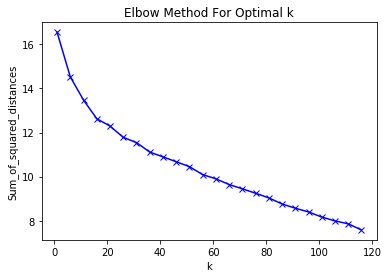

In [34]:
plt.plot(K, Sum_of_squared_distances, 'bx-')
plt.xlabel('k')
plt.ylabel('Sum_of_squared_distances')
plt.title('Elbow Method For Optimal k')
plt.show()

In [35]:
atlanta_grouped_clustering

,Yoga Studio,ATM,Accessories Store,Afghan Restaurant,African Restaurant,Airport Terminal,American Restaurant,Antique Shop,Arcade,Argentinian Restaurant,Art Gallery,Art Museum,Arts & Crafts Store,Asian Restaurant,Assisted Living,Athletics & Sports,Australian Restaurant,Auto Dealership,Auto Garage,Auto Workshop,Automotive Shop,BBQ Joint,Baby Store,Bagel Shop,Bakery,Bank,Bar,Baseball Field,Baseball Stadium,Beach,Bed & Breakfast,Beer Bar,Beer Garden,Beer Store,Big Box Store,Bike Rental / Bike Share,Bike Shop,Bistro,Board Shop,Boat or Ferry,Bookstore,Boutique,Bowling Alley,Boxing Gym,Brazilian Restaurant,Breakfast Spot,Brewery,Bridal Shop,Bubble Tea Shop,Buffet,Building,Burger Joint,Burrito Place,Bus Station,Bus Stop,Business Service,Butcher,Cafeteria,Café,Cajun / Creole Restaurant,Camera Store,Candy Store,Car Wash,Caribbean Restaurant,Carpet Store,Casino,Check Cashing Service,Chinese Restaurant,Chiropractor,Chocolate Shop,Church,Churrascaria,Climbing Gym,Clothing Store,Cocktail Bar,Coffee Shop,College Administrative Building,Comedy Club,Comfort Food Restaurant,Comic Shop,Concert Hall,Construction & Landscaping,Convenience Store,Cosmetics Shop,Costume Shop,Credit Union,Creperie,Cuban Restaurant,Cupcake Shop,Cycle Studio,Dance Studio,Deli / Bodega,Dentist's Office,Department Store,Dessert Shop,Dim Sum Restaurant,Diner,Discount Store,Distillery,Dive Bar,Doctor's Office,Dog Run,Donut Shop,Drugstore,Dry Cleaner,Eastern European Restaurant,Electronics Store,Empanada Restaurant,Ethiopian Restaurant,Event Service,Event Space,Eye Doctor,Fabric Shop,Falafel Restaurant,Farmers Market,Fast Food Restaurant,Filipino Restaurant,Financial or Legal Service,Fireworks Store,Fish & Chips Shop,Fish Market,Flea Market,Flower Shop,Fondue Restaurant,Food,Food & Drink Shop,Food Court,Food Service,Food Stand,Food Truck,Football Stadium,Frame Store,French Restaurant,Fried Chicken Joint,Frozen Yogurt Shop,Fruit & Vegetable Store,Furniture / Home Store,Gaming Cafe,Garden,Garden Center,Gas Station,Gastropub,Gay Bar,General College & University,General Entertainment,German Restaurant,Gift Shop,Gluten-free Restaurant,Golf Course,Gourmet Shop,Greek Restaurant,Grocery Store,Gun Range,Gun Shop,Gym,Gym / Fitness Center,Gym Pool,Gymnastics Gym,Halal Restaurant,Hardware Store,Hawaiian Restaurant,Health & Beauty Service,Health Food Store,Historic Site,History Museum,Hobby Shop,Hockey Arena,Hockey Field,Home Service,Hookah Bar,Hot Dog Joint,Hotel,Hotel Bar,Hotel Pool,Housing Development,Hunan Restaurant,IT Services,Ice Cream Shop,Indian Chinese Restaurant,Indian Restaurant,Indie Movie Theater,Indoor Play Area,Inn,Insurance Office,Internet Cafe,Intersection,Irish Pub,Italian Restaurant,Japanese Restaurant,Jewelry Store,Jewish Restaurant,Juice Bar,Karaoke Bar,Kebab Restaurant,Kids Store,Kitchen Supply Store,Korean Restaurant,Kosher Restaurant,Lake,Latin American Restaurant,Laundromat,Laundry Service,Lawyer,Light Rail Station,Lighting Store,Lingerie Store,Liquor Store,Locksmith,Lounge,Luggage Store,Mac & Cheese Joint,Malay Restaurant,Marijuana Dispensary,Market,Martial Arts Dojo,Massage Studio,Mattress Store,Medical Center,Medical Supply Store,Mediterranean Restaurant,Men's Store,Mexican Restaurant,Middle Eastern Restaurant,Mini Golf,Miscellaneous Shop,Mobile Phone Shop,Modern European Restaurant,Mongolian Restaurant,Moroccan Restaurant,Motel,Motorcycle Shop,Movie Theater,Moving Target,Multiplex,Museum,Music Store,Music Venue,Nail Salon,New American Restaurant,Nightclub,Non-Profit,Noodle House,Opera House,Optical Shop,Organic Grocery,Other Event,Other Repair Shop,Outdoor Supply Store,Outdoors & Recreation,Outlet Mall,Outlet Store,Paper / Office Supplies Store,Park,Parking,Performing Arts Venue,Perfume Shop,Persian Restaurant,Peruvian Restaurant,Pet Store,Pharmacy,Photography Lab,Photography Studio,Pilates Studio,Pizza Place,Playground,Plaza,Poke Place,Pool,Pool Hall,Print Shop,Pub,Ramen Restaurant,Record Shop,Recreation Center,Rental Car Location,Rental Service,Residential

In [36]:
kmeans

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=40, n_init=10, n_jobs=None, precompute_distances='auto',
    random_state=0, tol=0.0001, verbose=0)